In [98]:
import pandas
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math as m
from pprint import pprint
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

In [29]:
class bcolors:
    HEADER = '\033[95m'
    OKBLUE = '\033[94m'
    OKCYAN = '\033[96m'
    OKGREEN = '\033[92m'
    WARNING = '\033[93m'
    FAIL = '\033[91m'
    ENDC = '\033[0m'
    BOLD = '\033[1m'
    UNDERLINE = '\033[4m'

In [30]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [31]:
def transform_calc(current_len:int, prev_len:int) -> str:

  percent = current_len*100/prev_len
  return f'The current data frame is {percent:.2f}% of the initial size prior to transformation . There were {prev_len} rows and now there are {current_len} rows, with {prev_len - current_len} removed'

# 1. Data Description

Columns in historical_data.csv
1. **Time features**

  a. **market_id**: A city/region in which DoorDash operates, e.g., Los Angeles, given in the data as an id

  b. **created_at**: Timestamp in UTC when the order was submitted by the consumer to DoorDash. (Note this timestamp is in UTC, but in case you need it, the actual timezone of the region was US/Pacific)
  
  c. **actual_delivery_time**: Timestamp in UTC when the order was delivered to the consumer


2. **Store features**

  a. **store_id**: an id representing the restaurant the order was submitted for

  b. **store_primary_category**: cuisine category of the restaurant, e.g., italian, asian

  c. **order_protocol**: a store can receive orders from DoorDash through many modes. This field represents an id denoting the protocol

3. **Order features**

  a. **total_items**: total number of items in the order

  b. **subtotal**: total value of the order submitted (in cents)

  c. **num_distinct_items**: number of distinct items included in the order

  d. **min_item_price**: price of the item with the least cost in the order (in cents)

  e. **max_item_price**: price of the item with the highest cost in the order (in cents)

4. **Market features**: DoorDash being a marketplace, we have information on the state of marketplace when the order is placed, that can be used to estimate delivery time. The following features are values at the time of created_at (order submission time):

  a. **total_onshift_dashers**: Number of available dashers who are within 10 miles of the store at the time of order creation

  b. **total_busy_dashers**: Subset of above total_onshift_dashers who are currently working on an order

  c. **total_outstanding_orders**: Number of orders within 10 miles of this order that are currently being processed.


5. **Predictions from other models**: We have predictions from other models for various stages of delivery process that we can use:

  a. **estimated_order_place_duration**: Estimated time for the restaurant to receive the order from DoorDash (in seconds)

  b. **estimated_store_to_consumer_driving_duration**: Estimated travel time between store and consumer (in seconds)

6. **Practicalities**: Build a model to predict the total delivery duration seconds (as defined above). Feel free to generate additional features from the given data to improve model performance. Explain:

  * model(s) used,
  * how you evaluated your model performance on the historical data
  * any data processing you performed on the data
  * feature engineering choices you made
  * other information you would like to share your modeling approach

## a. load data and format data

In [32]:
df = pd.read_csv('/content/drive/My Drive/Door_dash_delivery_data/historical_data.csv')
df['actual_delivery_time'] = pd.to_datetime(df['actual_delivery_time'])
df['created_at'] = pd.to_datetime(df['created_at'])
df['created_at_hour'] = df['created_at'].dt.hour
df['order_id'] = df.index
df['estimated_order_place_duration'] = df['estimated_order_place_duration'] / 60
df['estimated_store_to_consumer_driving_duration'] = df['estimated_store_to_consumer_driving_duration'] / 60
df['order_time'] = (df['actual_delivery_time'] - df['created_at'])/pd.Timedelta(minutes=1)
df['store_primary_category'] =  df['store_primary_category'].fillna('unspecified')
df.head(10)
df_v0_size = len(df)
print(df_v0_size)

197428


## b. Inspect & Operate on nulls


In [33]:
null_count = df.isna().sum()
pprint(null_count)

market_id                                         987
created_at                                          0
actual_delivery_time                                7
store_id                                            0
store_primary_category                              0
order_protocol                                    995
total_items                                         0
subtotal                                            0
num_distinct_items                                  0
min_item_price                                      0
max_item_price                                      0
total_onshift_dashers                           16262
total_busy_dashers                              16262
total_outstanding_orders                        16262
estimated_order_place_duration                      0
estimated_store_to_consumer_driving_duration      526
created_at_hour                                     0
order_id                                            0
order_time                  

In [34]:
df.dropna(inplace=True)
df['order_time'] = df['order_time'].astype('int32')
df['order_id'] = df.index
df_v1_size = len(df)

In [35]:
df_stats_describe = df.describe()
df_stats_describe

,market_id,store_id,order_protocol,total_items,subtotal,num_distinct_items,min_item_price,max_item_price,total_onshift_dashers,total_busy_dashers,total_outstanding_orders,estimated_order_place_duration,estimated_store_to_consumer_driving_duration,created_at_hour,order_id,order_time
count,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000,179295.000000
mean,2.748593,3544.700650,2.895697,3.209086,2699.108386,2.678145,684.904972,1161.017346,44.815282,41.751410,58.062422,5.148542,9.098526,8.471363,98778.637279,47.291274
std,1.331761,2057.631297,1.515126,2.676064,1829.412565,1.627839,521.435971,562.110050,34.538853,32.158453,52.680403,1.506113,3.642886,8.676562,57018.717723,27.538517
min,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,-86.000000,0.000000,-4.000000,-5.000000,-6.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2.000000,1686.000000,1.000000,2.000000,1417.000000,2.000000,299.000000,799.000000,17.000000,15.000000,17.000000,4.183333,6.383333,2.000000,49431.500000,35.000000
50%,2.000000,3614.000000,3.000000,3.000000,2225.000000,2.000000,595.000000,1095.000000,37.000000,34.000000,41.000000,4.183333,9.066667,3.000000,99096.000000,44.000000
75%,4.000000,5323.000000,4.000000,4.000000,3414.000000,3.000000,942.000000,1395.000000,65.000000,62.000000,85.000000,7.433333,11.716667,19.000000,148276.500000,56.000000
max,6.000000,6987.000000,7.000000,411.000000,26800.000000,20.000000,14700.000000,14700.000000,171.000000,154.000000,285.000000,45.250000,34.800000,23.000000,197427.000000,6231.000000


In [36]:
strs = transform_calc(df_v1_size, df_v0_size).split(" . ")
for i in strs:
  print(i)

The current data frame is 90.82% of the initial size prior to transformation
There were 197428 rows and now there are 179295 rows, with 18133 removed


In [37]:
fig = make_subplots(rows=4, cols=3, subplot_titles=['total_items', 'subtotal', 'order_time', 'num_distinct_items', 'min_item_price', 'max_item_price', 'total_onshift_dashers', 'total_busy_dashers','total_outstanding_orders', 'estimated_order_place_duration'])
plot_list = [['total_items', 'subtotal', 'order_time'], ['num_distinct_items', 'min_item_price', 'max_item_price'], ['total_onshift_dashers', 'total_busy_dashers','total_outstanding_orders'], ['estimated_order_place_duration', 'estimated_store_to_consumer_driving_duration']]

for row_index, attribute_collection in enumerate(plot_list):
  for column_index, attribute in enumerate(attribute_collection):
    fig.add_trace(go.Box(y=df[attribute]), row=row_index+1, col=column_index+1)
fig.update_layout(height=1200, width=900, title_text="Box plots of all attributes")
fig.show()

In [38]:
# Filters to remove outliers. Note the data has more outlier in the segment above the upper fence
filter_total_items = df['total_items'] < 8
filter_order_time = df['order_time'] < 100
filter_sub_total = df['subtotal'] < 6388
filter_num_distinct_item = df['num_distinct_items'] < 7
filter_min_item_price = df['min_item_price'] < 1925
filter_max_item_price = df['max_item_price'] < 2288
filter_total_onshift_dashers = df['total_onshift_dashers'] < 172
filter_total_busy_dashers = df['total_busy_dashers'] < 133
filter_total_outstanding_orders = df['total_outstanding_orders'] < 188
filter_total_estimated_order_place_duration = df['estimated_order_place_duration'] < 28

# DataFrame 2
df_v2 = df.where(filter_total_items & filter_total_estimated_order_place_duration & filter_order_time & filter_sub_total & filter_num_distinct_item & filter_min_item_price & filter_max_item_price & filter_total_onshift_dashers & filter_total_busy_dashers & filter_total_outstanding_orders )
df_v2.dropna(inplace=True)

In [39]:
fig = make_subplots(rows=4, cols=3, subplot_titles=['total_items', 'subtotal', 'order_time', 'num_distinct_items', 'min_item_price', 'max_item_price', 'total_onshift_dashers', 'total_busy_dashers','total_outstanding_orders', 'estimated_order_place_duration'])
plot_list = [['total_items', 'subtotal', 'order_time'], ['num_distinct_items', 'min_item_price', 'max_item_price'], ['total_onshift_dashers', 'total_busy_dashers','total_outstanding_orders'], ['estimated_order_place_duration', 'estimated_store_to_consumer_driving_duration']]



for row_index, attribute_collection in enumerate(plot_list):
  for column_index, attribute in enumerate(attribute_collection):
    fig.add_trace(go.Box(y=df_v2[attribute], name=attribute), row=row_index+1, col=column_index+1)
fig.update_layout(height=1200, width=1200, title_text="Box plots of all attributes", xaxis_title="",
    yaxis_title="",)
fig.show()

In [40]:
df_v2.describe()

,market_id,store_id,order_protocol,total_items,subtotal,num_distinct_items,min_item_price,max_item_price,total_onshift_dashers,total_busy_dashers,total_outstanding_orders,estimated_order_place_duration,estimated_store_to_consumer_driving_duration,created_at_hour,order_id,order_time
count,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000,151605.000000
mean,2.755246,3562.423977,2.897273,2.754903,2307.560668,2.426866,654.010930,1068.231727,41.961406,39.013212,52.596636,5.150495,9.053093,8.958900,99343.696217,44.889997
std,1.338611,2061.256180,1.521688,1.470071,1242.322698,1.234028,406.053324,387.872269,31.881579,29.475296,45.698458,1.502371,3.640044,8.805527,56965.590819,15.531710
min,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,-86.000000,0.000000,-4.000000,-5.000000,-6.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2.000000,1700.000000,1.000000,2.000000,1340.000000,1.000000,300.000000,799.000000,16.000000,14.000000,16.000000,4.183333,6.333333,2.000000,50224.000000,34.000000
50%,2.000000,3620.000000,3.000000,2.000000,2037.000000,2.000000,599.000000,1025.000000,34.000000,32.000000,38.000000,4.183333,9.033333,3.000000,99817.000000,42.000000
75%,4.000000,5355.000000,4.000000,4.000000,3025.000000,3.000000,910.000000,1300.000000,61.000000,59.000000,78.000000,7.433333,11.666667,19.000000,149036.000000,54.000000
max,6.000000,6987.000000,7.000000,7.000000,6386.000000,6.000000,1924.000000,2287.000000,171.000000,132.000000,187.000000,27.883333,28.516667,23.000000,197427.000000,99.000000


In [41]:
strs = transform_calc(len(df_v2), df_v0_size).split(" . ")
for i in strs:
  print(i)

The current data frame is 76.79% of the initial size prior to transformation
There were 197428 rows and now there are 151605 rows, with 45823 removed


In [42]:
null_count = df_v2.isna().sum()
pprint(null_count)

market_id                                       0
created_at                                      0
actual_delivery_time                            0
store_id                                        0
store_primary_category                          0
order_protocol                                  0
total_items                                     0
subtotal                                        0
num_distinct_items                              0
min_item_price                                  0
max_item_price                                  0
total_onshift_dashers                           0
total_busy_dashers                              0
total_outstanding_orders                        0
estimated_order_place_duration                  0
estimated_store_to_consumer_driving_duration    0
created_at_hour                                 0
order_id                                        0
order_time                                      0
dtype: int64


# 2. Data Cleansing

In [43]:
df_v2.columns

Index(['market_id', 'created_at', 'actual_delivery_time', 'store_id',
       'store_primary_category', 'order_protocol', 'total_items', 'subtotal',
       'num_distinct_items', 'min_item_price', 'max_item_price',
       'total_onshift_dashers', 'total_busy_dashers',
       'total_outstanding_orders', 'estimated_order_place_duration',
       'estimated_store_to_consumer_driving_duration', 'created_at_hour',
       'order_id', 'order_time'],
      dtype='object')

In [44]:
order_feat_df = df_v2[['order_id','order_time', 'market_id', 'created_at','created_at_hour', 'actual_delivery_time', 'store_id', 'store_primary_category', 'order_protocol', 'total_items', 'subtotal', 'num_distinct_items', 'min_item_price', 'max_item_price']]
market_feat_df = df_v2[['order_id','order_time', 'market_id', 'created_at', 'actual_delivery_time', 'store_id', 'store_primary_category', 'order_protocol', 'total_onshift_dashers', 'total_busy_dashers' , 'total_outstanding_orders']]
estimate_df = df_v2[['order_id','order_time', 'market_id', 'created_at', 'actual_delivery_time', 'store_id', 'store_primary_category', 'order_protocol', 'estimated_order_place_duration', 'estimated_store_to_consumer_driving_duration']]

#3. Feature Inspection

## a. Order pair

[]

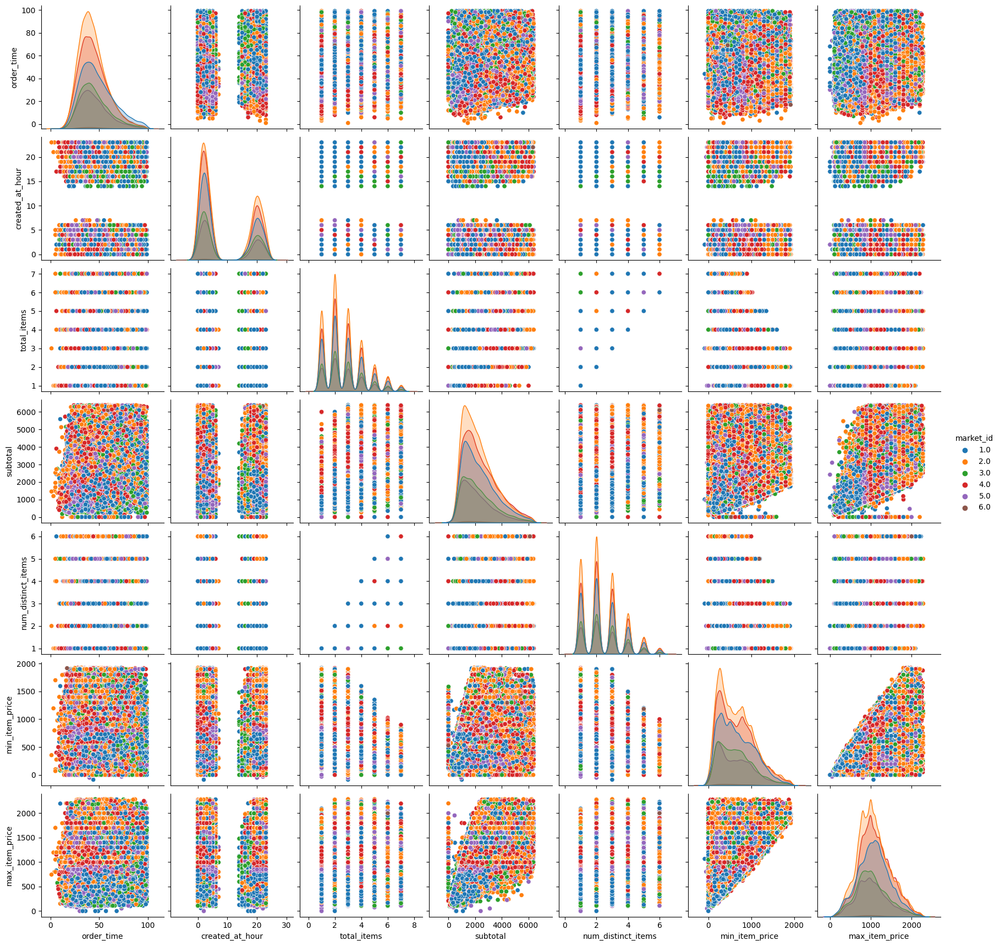

In [45]:
sns.pairplot(order_feat_df.drop(columns=['created_at', 'actual_delivery_time', 'store_id', 'order_id', 'order_protocol']), palette='tab10',hue='market_id')
plt.plot()

## b. Market Features Pair

[]

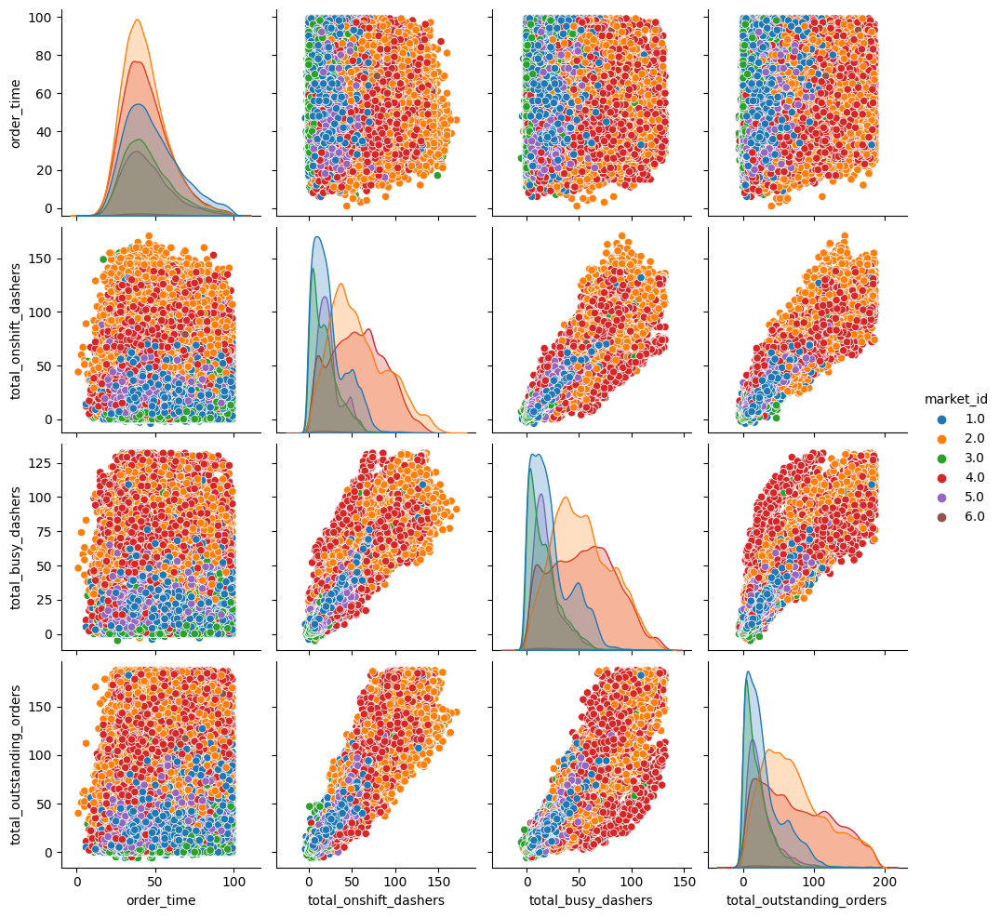

In [46]:
sns.pairplot(market_feat_df.drop(columns=['created_at', 'actual_delivery_time', 'store_id', 'order_id', 'order_protocol']),palette='tab10', hue='market_id')
plt.plot()

## c. Estimate Feature Pairs

[]

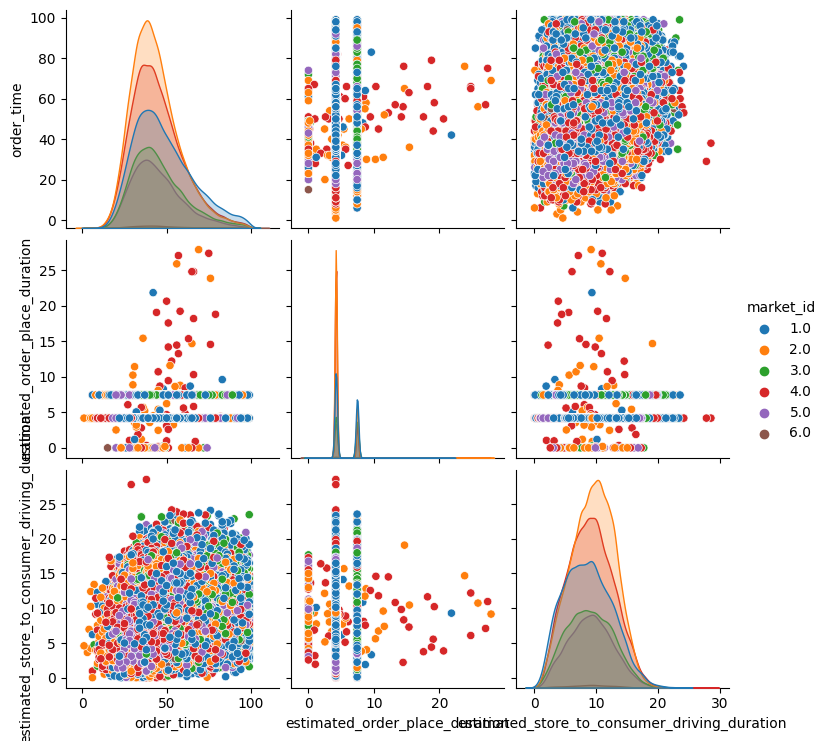

In [47]:
sns.pairplot(estimate_df.drop(columns=['created_at', 'actual_delivery_time', 'store_id', 'order_id', 'order_protocol']),palette='tab10', hue='market_id')
plt.plot()

[]

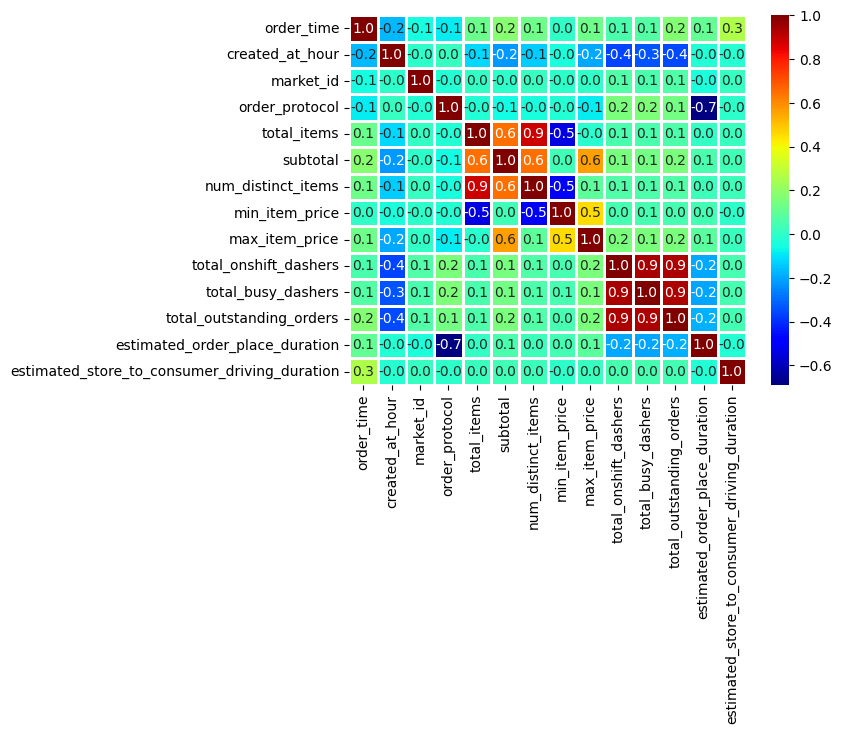

In [48]:
df_heatmap = pd.DataFrame(df_v2[['order_time','created_at_hour', 'market_id', 'order_protocol', 'total_items', 'subtotal', 'num_distinct_items', 'min_item_price', 'max_item_price', 'total_onshift_dashers', 'total_busy_dashers' , 'total_outstanding_orders', 'estimated_order_place_duration', 'estimated_store_to_consumer_driving_duration']])
sns.heatmap(df_heatmap.corr(), cmap = 'jet', annot=True, fmt='.1f', linewidth=.8)
plt.plot()

[]

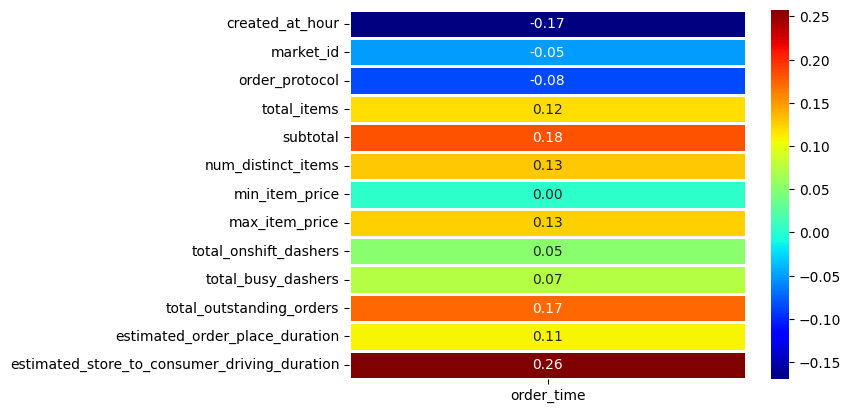

In [49]:
sns.heatmap(pd.DataFrame(df_heatmap.corr()['order_time'][1:]), cmap='jet', annot=True, fmt='.2f', linewidth=.8)
plt.plot()

# 4. Feature selection

Selecting the following features:

* created_at_hour (discreet, numeric, values => 23)
* total_items (discreet, numeric, values => 7)
* Subtotal (continuous, numeric, min => 0, max => 6386.000000)
* estimated_store_to_consumer_driving_duration (continuous, numeric, min => 0, max => 29)
* total_outstanding_orders (continous, numeric, min => -6, max => 187)
* estimated_order_place_duration (continuous, numeric, min => 0, max => 28)

In [50]:
df_v3 = df_v2[['order_id', 'order_time','market_id', 'store_id','created_at_hour','total_items','subtotal','estimated_store_to_consumer_driving_duration','total_outstanding_orders','estimated_order_place_duration']]
df_v3.head()

,order_id,order_time,market_id,store_id,created_at_hour,total_items,subtotal,estimated_store_to_consumer_driving_duration,total_outstanding_orders,estimated_order_place_duration
0,0.0,62.0,1.0,1845.0,22.0,4.0,3441.0,14.350000,21.0,7.433333
1,1.0,67.0,2.0,5477.0,21.0,1.0,1900.0,11.500000,2.0,7.433333
2,2.0,29.0,3.0,5477.0,20.0,1.0,1900.0,11.500000,0.0,7.433333
4,4.0,39.0,3.0,5477.0,2.0,3.0,3900.0,10.833333,9.0,7.433333
5,5.0,38.0,3.0,5477.0,20.0,3.0,5000.0,5.633333,2.0,7.433333


In [51]:
df_v3_describe = df_v3.describe()

In [54]:
df_v3_describe['subtotal']['min']

1.0

In [99]:
col_dict = {'created_at_hour' : 'numeric_discreet', 'total_items' : 'numeric_discreet', 'subtotal': 'numeric_cont', 'estimated_store_to_consumer_driving_duration': 'numeric_cont','total_outstanding_orders': 'numeric_cont', 'estimated_order_place_duration': 'numeric_cont'}
titles=[]
for i in col_dict.keys():
  titles.append(str(i) + '_median_order_time')
  titles.append(str(i) + '_count')
fig = make_subplots(rows=len(list(col_dict.keys())), cols=2, subplot_titles=titles)

for row_index, key in enumerate(col_dict.keys()):
  if col_dict[key] == 'numeric_discreet':
    dfg_median=df_v3[['order_time', str(key)]].groupby(by=[str(key)]).median()
    dfg_count=df_v3[['order_time', str(key)]].groupby(by=[str(key)]).count()
    fig.add_trace(go.Bar(x=dfg_median.index, y=dfg_median['order_time'], name=key), row=row_index+1, col=1)
    fig.add_trace(go.Bar(x=dfg_count.index, y=dfg_count['order_time'], name=key), row=row_index+1, col=2)
    dfg=[]
  if col_dict[key] == 'numeric_cont':
    min_val = int(m.floor(df_v3_describe[key]['min']))
    max_val = int(m.ceil(df_v3_describe[key]['max']))
    no_of_bins=6
    differential = int(m.ceil((max_val-min_val)/no_of_bins))
    bin_list = list(range(min_val, max_val + differential, differential))
    label_list = []
    for index, bin_start in enumerate(bin_list):
      if index + 2 < len(bin_list):
        label_list.append(f'{bin_start} - {bin_list[index + 1]}')
      elif index + 2 == len(bin_list):
        label_list.append(f'{bin_start} +')

    dff=df_v3[['order_time', str(key)]]
    dff[f'{key}_bin'] = pd.cut(dff[key], bin_list, labels=label_list)
    dfg_median=dff[[f'{key}_bin', 'order_time']].groupby(by=[f'{key}_bin']).median()
    dfg_count=dff[[f'{key}_bin', 'order_time']].groupby(by=[f'{key}_bin']).count()
    fig.add_trace(go.Bar(x=dfg_median.index, y=dfg_median['order_time'], name=key), row=row_index+1, col=1)
    fig.add_trace(go.Bar(x=dfg_count.index, y=dfg_count['order_time'], name=key), row=row_index+1, col=2)

fig.update_layout(height=1200, width=1100, title_text="Hist plots of all attributes", showlegend=False)
fig.show()
